In [18]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.interpolate import interp1d
import matplotlib.animation as animation

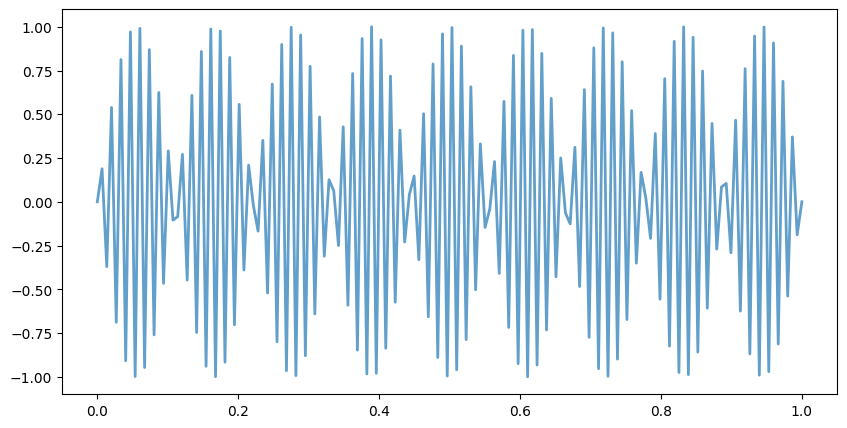

In [17]:
T0=1.0
phi=0
A=1 #amplitude
f=70 #Hz

t = np.linspace(0, T0, 150) 
sinusoidal=A * np.sin(2 * np.pi * f * t + phi)
plt.figure(figsize=(10,5))
plt.plot(t,sinusoidal,linewidth=2,alpha=0.7)

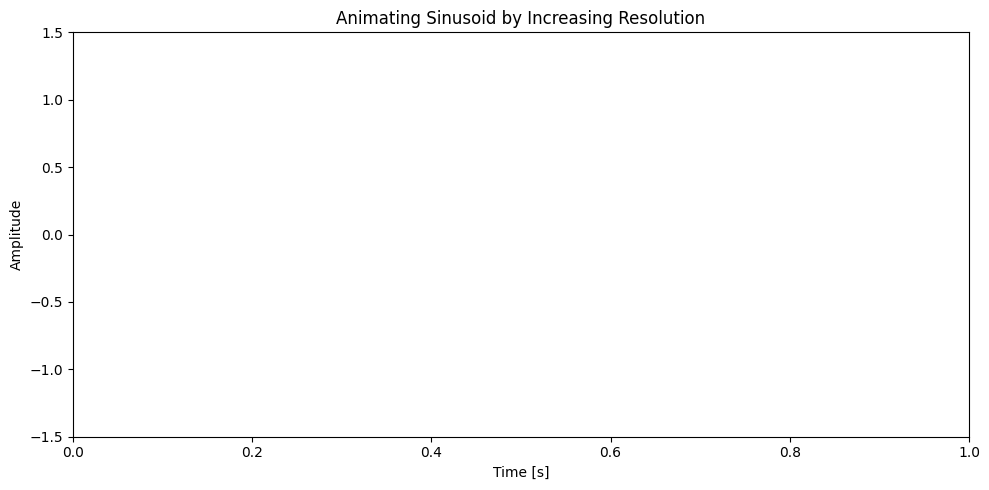

In [28]:
# Constants
T0 = 1.0
phi = 0
A = 1  # amplitude
f = 70  # Hz
# Set up the figure and axis
fig, ax = plt.subplots(figsize=(10, 5))
line, = ax.plot([], [], lw=2, alpha=0.7)
ax.set_xlim(0, T0)
ax.set_ylim(-A - 0.5, A + 0.5)
ax.set_title("Animating Sinusoid by Increasing Resolution")
ax.set_xlabel("Time [s]")
ax.set_ylabel("Amplitude")

# Initialization function
def init():
    line.set_data([], [])
    return line,

# Update function for animation
def update(end):
    t = np.linspace(0, T0, 150)
    sinusoidal = A * np.sin(2 * np.pi * f * t + phi)
    line.set_data(t, sinusoidal)
    end+=1
    return line,

# Create animation: frame values will be from 10 to 150 (inclusive)
ani = animation.FuncAnimation(fig, update, frames=range(10, 151, 2),
                              init_func=init, blit=True, interval=50, repeat=False)

plt.tight_layout()
plt.show()
HTML(ani.to_jshtml())

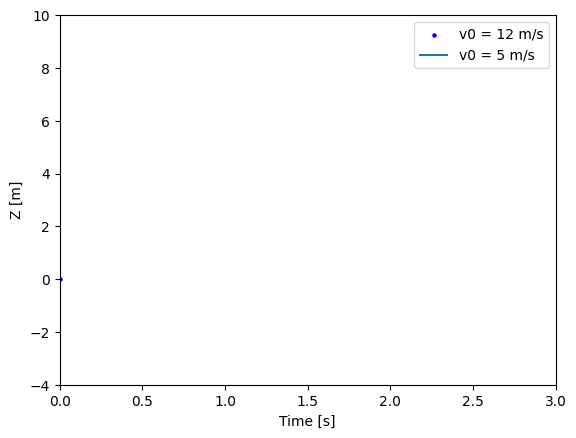

In [27]:
fig, ax = plt.subplots()
t = np.linspace(0, 3, 40)
g = -9.81
v0 = 12
z = g * t**2 / 2 + v0 * t

v02 = 5
z2 = g * t**2 / 2 + v02 * t

scat = ax.scatter(t[0], z[0], c="b", s=5, label=f'v0 = {v0} m/s')
line2 = ax.plot(t[0], z2[0], label=f'v0 = {v02} m/s')[0]
ax.set(xlim=[0, 3], ylim=[-4, 10], xlabel='Time [s]', ylabel='Z [m]')
ax.legend()


def update(frame):
    # for each frame, update the data stored on each artist.
    x = t[:frame]
    y = z[:frame]
    # update the scatter plot:
    data = np.stack([x, y]).T
    scat.set_offsets(data)
    # update the line plot:
    line2.set_xdata(t[:frame])
    line2.set_ydata(z2[:frame])
    return (scat, line2)


ani = animation.FuncAnimation(fig=fig, func=update, frames=40, interval=30)
plt.show()
HTML(ani.to_jshtml())

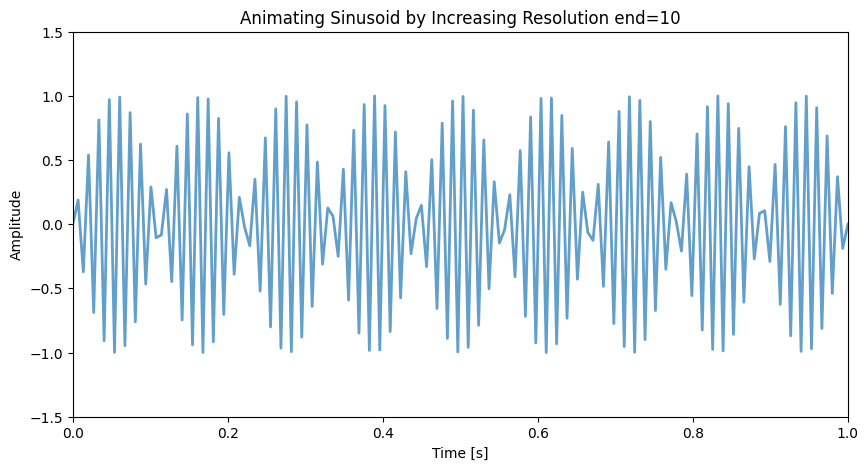

In [33]:

from IPython.display import HTML

# Constants
T0 = 1.0
phi = 0
A = 1  # amplitude
f = 70  # Hz
# Set up the figure and axis
fig, ax = plt.subplots(figsize=(10, 5))
line, = ax.plot([], [], lw=2, alpha=0.7)
ax.set_xlim(0, T0)
ax.set_ylim(-A - 0.5, A + 0.5)
ax.set_title("Animating Sinusoid by Increasing Resolution")
ax.set_xlabel("Time [s]")
ax.set_ylabel("Amplitude")

# Initialization function
def init():
    line.set_data([], [])
    return line,

# Update function for animation
def update(end):
    t = np.linspace(0, T0, end)
    sinusoidal = A * np.sin(2 * np.pi * f * t + phi)
    line.set_data(t, sinusoidal)
    return line,

# Create animation
ani = animation.FuncAnimation(fig, update, frames=range(10, 151, 1),
                              init_func=init, blit=True, interval=100, repeat=False)

# Display animation in Jupyter
HTML(ani.to_jshtml())

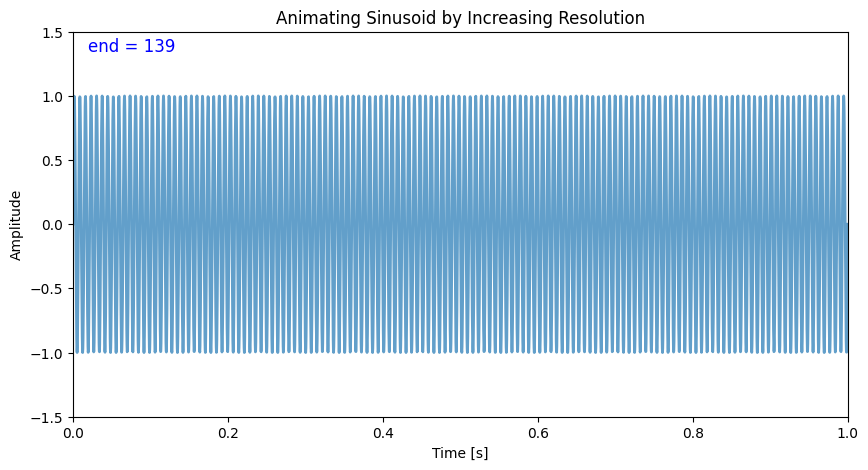

In [47]:
# Constants
T0 = 1.0
phi = 0
A = 1  # amplitude
f = 5  # Hz

# Set up the figure and axis
fig, ax = plt.subplots(figsize=(10, 5))
line, = ax.plot([], [], lw=2, alpha=0.7)
text = ax.text(0.02, 0.95, '', transform=ax.transAxes, fontsize=12, color='blue')

ax.set_xlim(0, T0)
ax.set_ylim(-A - 0.5, A + 0.5)
ax.set_title("Animating Sinusoid by Increasing Resolution")
ax.set_xlabel("Time [s]")
ax.set_ylabel("Amplitude")

# Initialization function
def init():
    line.set_data([], [])
    text.set_text('')
    return line, text

# Update function for animation
def update(f):
    t = np.linspace(0, T0, 3500)
    sinusoidal = A * np.sin(2 * np.pi * f * t + phi)
    line.set_data(t, sinusoidal)
    text.set_text(f'end = {f}')
    return line, text

# Create animation
ani = animation.FuncAnimation(fig, update, frames=range(5, 140, 1),
                              init_func=init, blit=True, interval=100, repeat=False)

# Display animation in Jupyter
HTML(ani.to_jshtml())

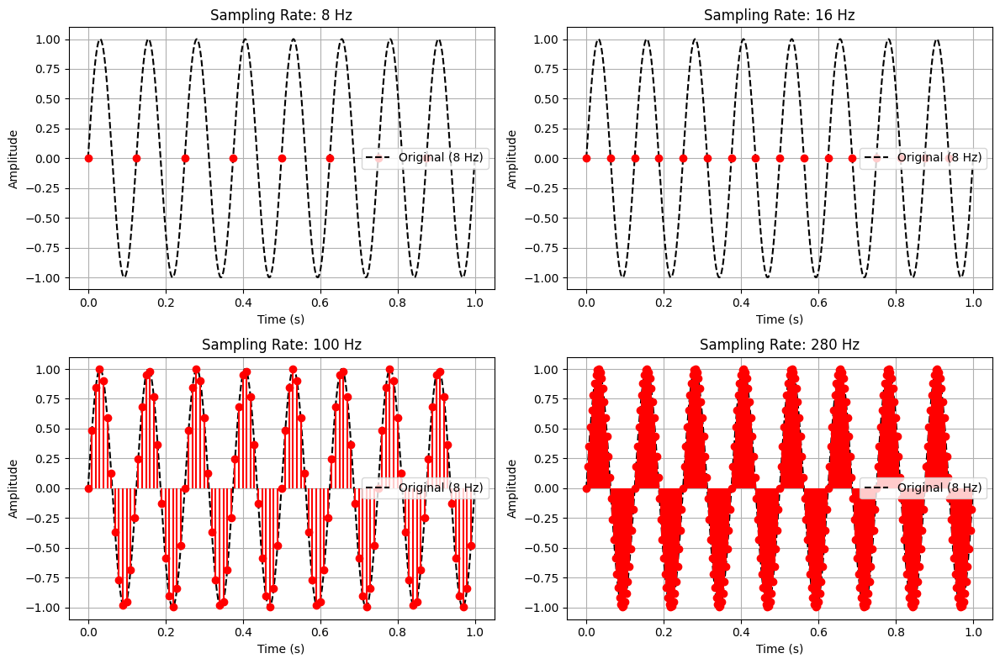

In [45]:
import numpy as np
import matplotlib.pyplot as plt

# Signal parameters
freq = 8  # Hz
amplitude = 1
duration = 1  # seconds

# Sampling rates to test
sampling_rates = [8, 16, 100, 280]

# Time for original continuous signal (for reference)
t_cont = np.linspace(0, duration, 1000)
y_cont = amplitude * np.sin(2 * np.pi * freq * t_cont)

# Plotting
plt.figure(figsize=(12, 8))

for i, sr in enumerate(sampling_rates, 1):
    t_sampled = np.linspace(0, duration, int(duration * sr), endpoint=False)
    y_sampled = amplitude * np.sin(2 * np.pi * freq * t_sampled)

    plt.subplot(2, 2, i)
    plt.plot(t_cont, y_cont, 'k--', label='Original (8 Hz)')
    
    # Remove use_line_collection
    markerline, stemlines, baseline = plt.stem(t_sampled, y_sampled, linefmt='r-', markerfmt='ro', basefmt=' ')
    
    plt.title(f"Sampling Rate: {sr} Hz")
    plt.xlabel("Time (s)")
    plt.ylabel("Amplitude")
    plt.grid(True)
    plt.legend()

plt.tight_layout()
plt.show()
